In [33]:
import numpy as np
import pandas as pd
import keras
from keras import layers
from keras import models, optimizers
from keras.layers.normalization import BatchNormalization
from keras.preprocessing.image import ImageDataGenerator
import keras.backend as K
from keras.backend.tensorflow_backend import set_session
import tensorflow as tf
import matplotlib.pyplot as plt
from keras.layers import Activation
%matplotlib inline


## Ques 1

In [34]:
class ConvolutionNet():
    def __init__(self, hidden_units=512,conv_depth=4,dense_depth=1):
        self.hidden_units = hidden_units
        self.conv_depth = conv_depth
        self.dense_depth = dense_depth
    def build_model(self,
                   hidden_act='relu',
                   out_act='softmax',
                   num_filters = 32,
                   optimizer = 'adam',
                   learning_rate=0.001,
                   loss = 'categorical_crossentropy',
                   metrics = ['acc']):
        self.model = models.Sequential()
        self.model.add(layers.Conv2D(num_filters,(3,3),input_shape=(150,150,3)))
        self.model.add(BatchNormalization())
        self.model.add(Activation(hidden_act))
        self.model.add(layers.MaxPooling2D((2,2)))
        #self.model.add(layers.Dropout(0.5))
        for _ in range(self.conv_depth-1):
            self.model.add(layers.Conv2D(num_filters*2,(3,3)))
            self.model.add(BatchNormalization())
            self.model.add(Activation(hidden_act))
            self.model.add(layers.MaxPooling2D((2,2)))
            #self.model.add(layers.Dropout(0.5))
        self.model.add(layers.Flatten())
        for _ in range(self.dense_depth):
            self.model.add(layers.Dense(self.hidden_units,activation=hidden_act))
            
        self.model.add(layers.Dense(1,activation=out_act))
        opt = None
        if optimizer == 'adam':
            opt = optimizers.Adam(lr=learning_rate)
        if optimizer == 'rmsprop':
            opt = optimizers.RMSprop(lr=learning_rate)
        self.model.compile(
                optimizer = opt,
                loss = loss,
                metrics = metrics)
    def fit(self,train_gen,hyperparams,**kwargs):
        K.clear_session()
        config = tf.ConfigProto()
        config.gpu_options.per_process_gpu_memory_fraction = 0.25
        sess = tf.Session(config=config)
        set_session(sess)
        if hyperparams:
            self.build_model(**hyperparams)
        else:
            self.build_model()
        self.history = self.model.fit_generator(train_gen,**kwargs)

In [35]:
train_dir = '/data/ttran/imgdata/train'
validation_dir = '/data/ttran/imgdata/validation'
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
train_generator = train_datagen.flow_from_directory(train_dir,target_size=(150,150),batch_size=20,class_mode='binary')
validation_generator = test_datagen.flow_from_directory(validation_dir,target_size=(150,150),batch_size=20,class_mode='binary')

Found 2551 images belonging to 2 classes.
Found 639 images belonging to 2 classes.


In [36]:
import math

In [37]:
cnn = ConvolutionNet()
hyperparams = dict(out_act='sigmoid',optimizer='adam',learning_rate=1e-5,loss='binary_crossentropy')
cnn.fit(train_generator,
        hyperparams,
        steps_per_epoch=math.ceil(2551/20),
        epochs=30,
        validation_data=validation_generator,
        validation_steps=math.ceil(639/20))

Epoch 1/30
128/128 [==============================] - 16s 126ms/step - loss: 0.6999 - acc: 0.5710 - val_loss: 0.6839 - val_acc: 0.6041
Epoch 2/30
128/128 [==============================] - 15s 113ms/step - loss: 0.6164 - acc: 0.6526 - val_loss: 0.6607 - val_acc: 0.6291
Epoch 3/30
128/128 [==============================] - 14s 111ms/step - loss: 0.5693 - acc: 0.7000 - val_loss: 0.6449 - val_acc: 0.6541
Epoch 4/30
128/128 [==============================] - 14s 113ms/step - loss: 0.5354 - acc: 0.7397 - val_loss: 0.6327 - val_acc: 0.6667
Epoch 5/30
128/128 [==============================] - 15s 119ms/step - loss: 0.5011 - acc: 0.7587 - val_loss: 0.6258 - val_acc: 0.6635
Epoch 6/30
128/128 [==============================] - 15s 116ms/step - loss: 0.4677 - acc: 0.7921 - val_loss: 0.6362 - val_acc: 0.6479
Epoch 7/30
128/128 [==============================] - 15s 118ms/step - loss: 0.4446 - acc: 0.8020 - val_loss: 0.6098 - val_acc: 0.6808
Epoch 8/30
128/128 [==============================] - 1

In [38]:
hist = cnn.history.history

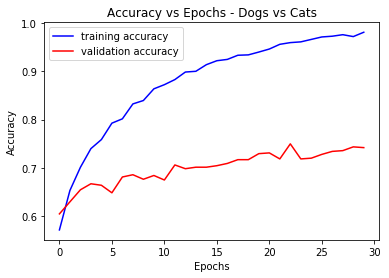

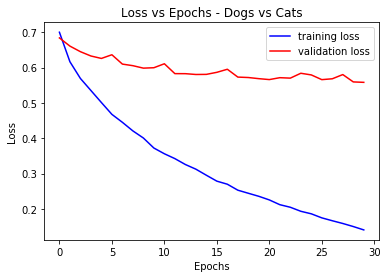

In [39]:
import matplotlib.pyplot as plt
%matplotlib inline

#plt.plot()
plt.plot(hist['acc'],'b',label="training accuracy")
plt.plot(hist['val_acc'],'r',label = "validation accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title('Accuracy vs Epochs - Dogs vs Cats')
plt.legend()
#plt.savefig('ques1_acc_norm')

plt.figure()
#plt.plot()
plt.plot(hist['loss'],'b',label="training loss")
plt.plot(hist['val_loss'],'r',label = "validation loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title('Loss vs Epochs - Dogs vs Cats')
plt.legend()
#plt.savefig('ques1_loss_norm')

In [8]:
conv_layers = ['conv2d_1','conv2d_2','conv2d_3','conv2d_4']
cnn.model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_1 (Conv2D)            (None, 148, 148, 32)      896       
_________________________________________________________________
batch_normalization_1 (Batch (None, 148, 148, 32)      128       
_________________________________________________________________
activation_1 (Activation)    (None, 148, 148, 32)      0         
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 74, 74, 32)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 72, 72, 64)        18496     
_________________________________________________________________
batch_normalization_2 (Batch (None, 72, 72, 64)        256       
_________________________________________________________________
activation_2 (Activation)    (None, 72, 72, 64)        0         
__________

In [9]:
from keras.preprocessing import image
img = image.load_img('/data/ttran/imgdata/test/Cat/12.jpg',target_size=(150,150))
img_tensor = image.img_to_array(img)
#Expand shape to (1,150,150,3)
img_tensor = np.expand_dims(img_tensor,axis=0)
#Normalize to [0,1]
img_tensor /= 255.

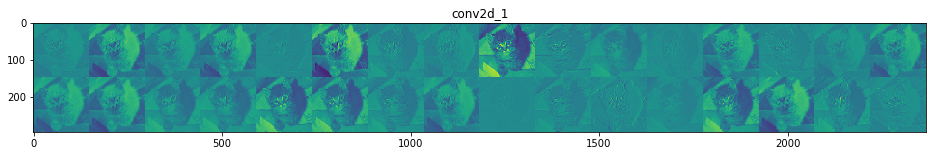

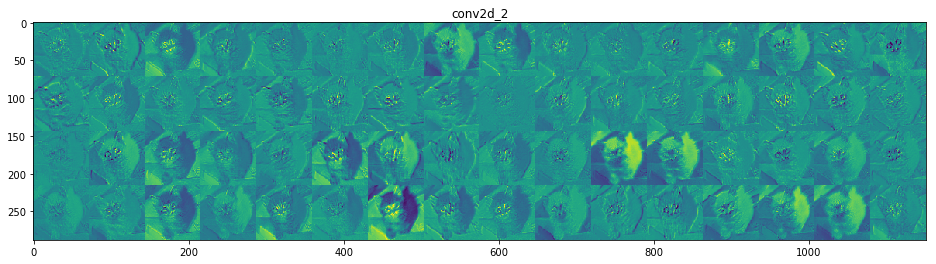

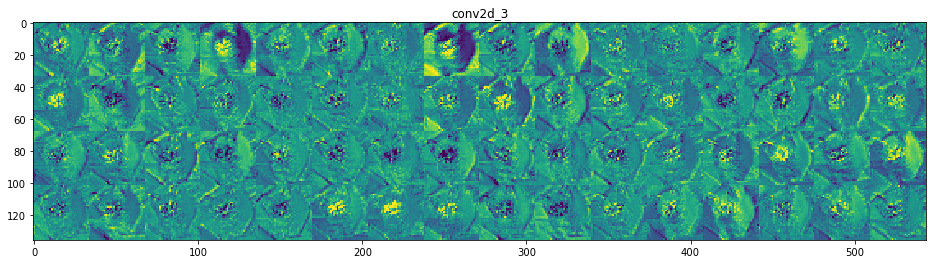

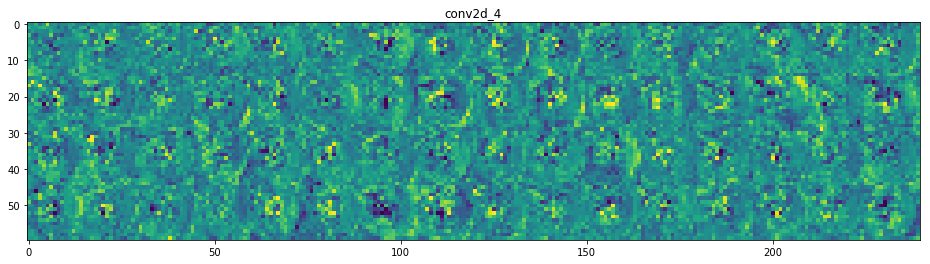

In [11]:
# Activation visualization when there's no dropout
from keras import models
layer_outputs = [layer.output for layer in cnn.model.layers[:16]]
layer_names = [layer.name for layer in cnn.model.layers[:16]]
act_model = models.Model(inputs=cnn.model.input,outputs = layer_outputs)
activations = act_model.predict(img_tensor)
images_per_row = 16
for layer_name, layer_act in zip(layer_names, activations):
    if layer_name in conv_layers:
        #layer_act.shape = (1,size,size,n_channels)
        n_channels = layer_act.shape[-1]
        size = layer_act.shape[1]
        n_cols = n_channels // images_per_row
        display_grid = np.zeros((size*n_cols,images_per_row*size))
        for col in range(n_cols):
            for row in range(images_per_row):
                #Retrieve i-th channel
                channel_image = layer_act[0,:,:,col*images_per_row+row]
                #normalize
                channel_image -= channel_image.mean()
                channel_image /- channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image,0, 255).astype('uint8')
                display_grid[col*size: (col+1)*size, row*size: (row+1)*size] = channel_image
        scale = 1./size
        plt.figure(figsize=(scale*display_grid.shape[1],scale*display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid,aspect='auto',cmap='viridis')
        plt.savefig('ques1_{}_act'.format(layer_name))

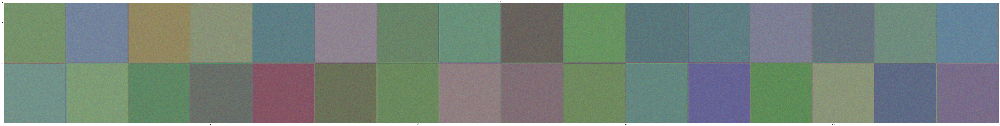

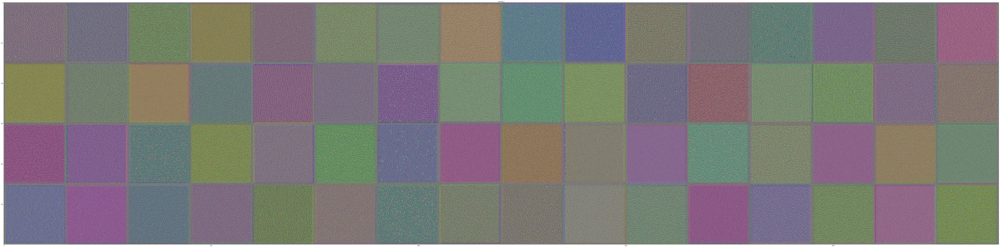

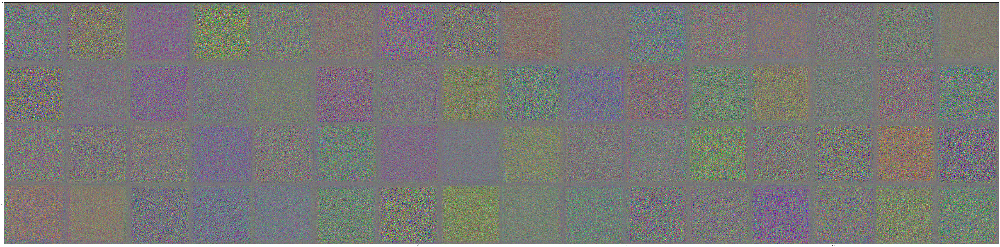

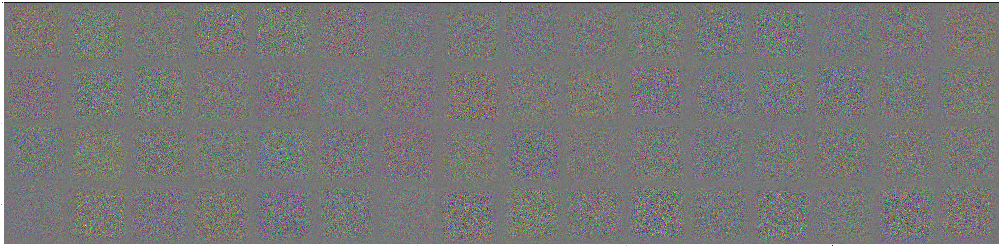

In [15]:
# Filter visualization
layer_outputs = [layer.output for layer in cnn.model.layers[:16]]
layer_names = [layer.name for layer in cnn.model.layers[:16]]
images_per_row = 16
for layer_output, layer_name in zip(layer_outputs,layer_names):
    if layer_name in conv_layers:
        n_channels = int(layer_output.shape[-1])
        #size = int(layer_output.shape[1])
        n_cols = n_channels // images_per_row
        display_grid = np.zeros((150*n_cols,images_per_row*150,3))
        for col in range(n_cols):
            for row in range(images_per_row):
                loss = K.mean(layer_output[:,:,:,col*images_per_row+row])
                grads = K.gradients(loss, cnn.model.input)[0]
                grads /= K.sqrt(K.mean(K.square(grads))) + 1e-5
                f = K.function([cnn.model.input],[loss,grads])
                input_img = np.random.random((1,150,150,3)) * 20 + 128
                step = 1.
                for i in range(40):
                    loss_value, grads_value = f([input_img])
                    input_img += grads_value * step
                input_img = input_img[0]
#                 input_img -= input_img.mean()
#                 input_img /= (input_img.std() + 1e-5)
#                 input_img *= 0.1
#                 input_img += 0.5
#                 input_img = np.clip(input_img,0,1)
#                 input_img*=255
                input_img = np.array(input_img).astype('uint8')
                display_grid[col*150: (col+1)*150, row*150: (row+1)*150,:] = input_img
        scale = 1./size
        plt.figure(figsize=(scale*display_grid.shape[1],scale*display_grid.shape[0]))
        plt.title(layer_name)
        plt.grid(False)
        plt.imshow(display_grid,aspect='auto',cmap='viridis')
        plt.savefig('ques1_{}_filter_vis'.format(layer_name))

In [16]:
test_datagen = ImageDataGenerator(rescale=1./255)

In [28]:
from keras.applications import VGG16
K.clear_session()
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.25
sess = tf.Session(config=config)
set_session(sess)
conv_base = VGG16(weights='imagenet',include_top=False,input_shape=(150,150,3))
train_dir = '/data/ttran/imgdata/train'
validation_dir = '/data/ttran/imgdata/validation'
train_datagen = ImageDataGenerator(rescale=1./255)
test_datagen = ImageDataGenerator(rescale=1./255)
train_generator = train_datagen.flow_from_directory(train_dir,target_size=(150,150),batch_size=20,class_mode='binary')
validation_generator = test_datagen.flow_from_directory(validation_dir,target_size=(150,150),batch_size=20,class_mode='binary')
model = models.Sequential()
conv_base.trainable = False
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(512,activation='relu'))
model.add(layers.Dense(1,activation='sigmoid'))
model.compile(
    optimizer=optimizers.Adam(lr=1e-5),
    loss='binary_crossentropy',
    metrics=['acc'])
history = model.fit_generator(train_generator,
                            steps_per_epoch=math.ceil(2551/20),
                            epochs=30,
                            validation_data=validation_generator,
                            validation_steps=math.ceil(639/20))

Found 2551 images belonging to 2 classes.
Found 639 images belonging to 2 classes.
Epoch 1/30
128/128 [==============================] - 17s 129ms/step - loss: 0.5185 - acc: 0.7647 - val_loss: 0.4182 - val_acc: 0.8419
Epoch 2/30
128/128 [==============================] - 14s 112ms/step - loss: 0.3589 - acc: 0.8645 - val_loss: 0.3421 - val_acc: 0.8623
Epoch 3/30
128/128 [==============================] - 14s 112ms/step - loss: 0.3003 - acc: 0.8915 - val_loss: 0.3064 - val_acc: 0.8748
Epoch 4/30
128/128 [==============================] - 14s 109ms/step - loss: 0.2680 - acc: 0.9083 - val_loss: 0.2861 - val_acc: 0.8905
Epoch 5/30
128/128 [==============================] - 15s 117ms/step - loss: 0.2429 - acc: 0.9138 - val_loss: 0.2728 - val_acc: 0.8889
Epoch 6/30
128/128 [==============================] - 15s 118ms/step - loss: 0.2223 - acc: 0.9246 - val_loss: 0.2730 - val_acc: 0.8873
Epoch 7/30
128/128 [==============================] - 15s 115ms/step - loss: 0.2060 - acc: 0.9305 - val_los

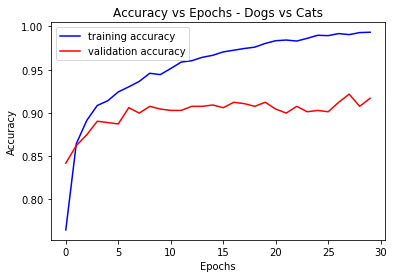

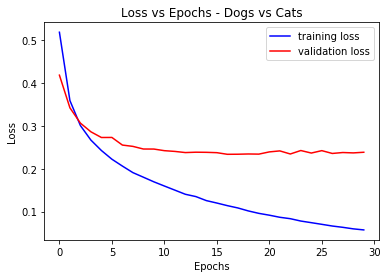

In [30]:
hist = history.history
plt.plot(hist['acc'],'b',label="training accuracy")
plt.plot(hist['val_acc'],'r',label = "validation accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title('Accuracy vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_acc_frozen_pretrained')

plt.figure()
#plt.plot()
plt.plot(hist['loss'],'b',label="training loss")
plt.plot(hist['val_loss'],'r',label = "validation loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title('Loss vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_loss_frozen_pretrained')

In [31]:
print(len(model.trainable_weights))

4


30
Epoch 1/30
128/128 [==============================] - 20s 155ms/step - loss: 0.0583 - acc: 0.9773 - val_loss: 0.2214 - val_acc: 0.9218
Epoch 2/30
128/128 [==============================] - 17s 136ms/step - loss: 0.0159 - acc: 0.9973 - val_loss: 0.2944 - val_acc: 0.9092
Epoch 3/30
128/128 [==============================] - 18s 139ms/step - loss: 0.0120 - acc: 0.9977 - val_loss: 0.2308 - val_acc: 0.9358
Epoch 4/30
128/128 [==============================] - 18s 140ms/step - loss: 0.0014 - acc: 1.0000 - val_loss: 0.2468 - val_acc: 0.9358
Epoch 5/30
128/128 [==============================] - 18s 139ms/step - loss: 5.2870e-04 - acc: 1.0000 - val_loss: 0.2448 - val_acc: 0.9343
Epoch 6/30
128/128 [==============================] - 18s 141ms/step - loss: 2.7234e-04 - acc: 1.0000 - val_loss: 0.2557 - val_acc: 0.9374
Epoch 7/30
128/128 [==============================] - 18s 137ms/step - loss: 1.8465e-04 - acc: 1.0000 - val_loss: 0.2641 - val_acc: 0.9374
Epoch 8/30
128/128 [====================

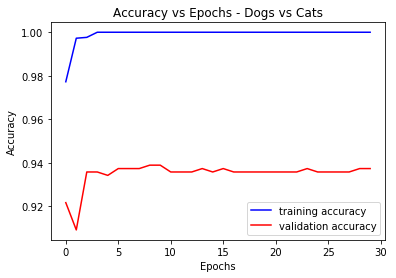

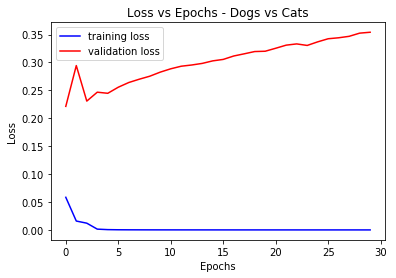

In [32]:
#Unfreeze conv base
conv_base.trainable = True
print(len(model.trainable_weights))
model.compile(
    optimizer=optimizers.Adam(lr=1e-5),
    loss='binary_crossentropy',
    metrics=['acc'])
history = model.fit_generator(train_generator,
                            steps_per_epoch=math.ceil(2551/20),
                            epochs=30,
                            validation_data=validation_generator,
                            validation_steps=math.ceil(639/20))
hist = history.history
plt.figure()
plt.plot(hist['acc'],'b',label="training accuracy")
plt.plot(hist['val_acc'],'r',label = "validation accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title('Accuracy vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_acc_unfreeze')

plt.figure()
#plt.plot()
plt.plot(hist['loss'],'b',label="training loss")
plt.plot(hist['val_loss'],'r',label = "validation loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title('Loss vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_loss_unfreeze')

Found 2551 images belonging to 2 classes.
Found 639 images belonging to 2 classes.
Epoch 1/30
128/128 [==============================] - 27s 210ms/step - loss: 0.6189 - acc: 0.6646 - val_loss: 0.4829 - val_acc: 0.8075
Epoch 2/30
128/128 [==============================] - 24s 190ms/step - loss: 0.5025 - acc: 0.7865 - val_loss: 0.4007 - val_acc: 0.8388
Epoch 3/30
128/128 [==============================] - 25s 196ms/step - loss: 0.4451 - acc: 0.8111 - val_loss: 0.3513 - val_acc: 0.8576
Epoch 4/30
128/128 [==============================] - 25s 192ms/step - loss: 0.4207 - acc: 0.8190 - val_loss: 0.3233 - val_acc: 0.8638
Epoch 5/30
128/128 [==============================] - 24s 191ms/step - loss: 0.3911 - acc: 0.8392 - val_loss: 0.3094 - val_acc: 0.8685
Epoch 6/30
128/128 [==============================] - 25s 194ms/step - loss: 0.3832 - acc: 0.8310 - val_loss: 0.2930 - val_acc: 0.8764
Epoch 7/30
128/128 [==============================] - 25s 196ms/step - loss: 0.3639 - acc: 0.8462 - val_los

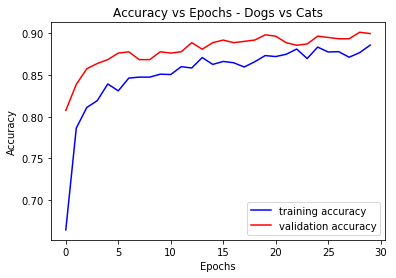

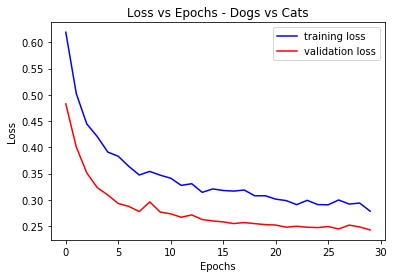

In [40]:
# Data augmentation + retrain with frozen conv base
#del model
from keras.applications import VGG16
K.clear_session()
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.25
sess = tf.Session(config=config)
set_session(sess)
train_dir = '/data/ttran/imgdata/train'
validation_dir = '/data/ttran/imgdata/validation'
train_datagen = ImageDataGenerator(rescale=1./255,
                                   rotation_range=40,
                                   width_shift_range=0.2,
                                   height_shift_range=0.2,
                                   shear_range=0.2,
                                   zoom_range=0.2,
                                   horizontal_flip=True,
                                   fill_mode='nearest'
                                  )
train_generator = train_datagen.flow_from_directory(train_dir,target_size=(150,150),batch_size=20,class_mode='binary')
validation_generator = test_datagen.flow_from_directory(validation_dir,target_size=(150,150),batch_size=20,class_mode='binary')
conv_base = VGG16(weights='imagenet',include_top=False,input_shape=(150,150,3))
model = models.Sequential()
conv_base.trainable = False
model.add(conv_base)
model.add(layers.Flatten())
model.add(layers.Dense(512,activation='relu'))
model.add(layers.Dense(1,activation='sigmoid'))
model.compile(
    optimizer=optimizers.Adam(lr=1e-5),
    loss='binary_crossentropy',
    metrics=['acc'])
history = model.fit_generator(train_generator,
                            steps_per_epoch=math.ceil(2551/20),
                            epochs=30,
                            validation_data=validation_generator,
                            validation_steps=math.ceil(639/20))
hist = history.history
plt.figure()
plt.plot(hist['acc'],'b',label="training accuracy")
plt.plot(hist['val_acc'],'r',label = "validation accuracy")
plt.xlabel("Epochs")
plt.ylabel("Accuracy")
plt.title('Accuracy vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_acc_freeze_dataaug')

plt.figure()
#plt.plot()
plt.plot(hist['loss'],'b',label="training loss")
plt.plot(hist['val_loss'],'r',label = "validation loss")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.title('Loss vs Epochs - Dogs vs Cats')
plt.legend()
plt.savefig('ques1_loss_freeze_dataaug')